# Analyzing Oligopoly Competition in Game Theory using Monte Carlo Simulation: Cournot Model

### By Ayush Majumdar

In [1]:
# importing the libraries
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import math
from scipy.stats import lognorm
from Helper import *

In [2]:
num_iterations = 10000
demand_curve_coefficient = 100
# Firms have marginal cost of production
c1 = 30
c2 = 40

## Simulation 1: Firm 1 & Firm 2 have random quantity of production 

In [3]:
df = mc_sim(
    num_iterations=num_iterations,
    demand_curve_coefficient=demand_curve_coefficient,
    c1=c1,
    c2=c2,
    q1max=101,
    q2=0,
    method='random'
)
df

,Firm 1 Quantity,Firm 2 Quantity,Firm 1 Profit,Firm 2 Profit
0,76,54,-10336,-6696
1,26,7,286,140
2,47,30,-2538,-1410
3,100,76,-20600,-14592
4,73,48,-9052,-5232
...,...,...,...,...
9995,36,23,-900,-506
9996,92,17,-12052,-1122
9997,17,99,-1071,-15345
9998,94,63,-17014,-10080


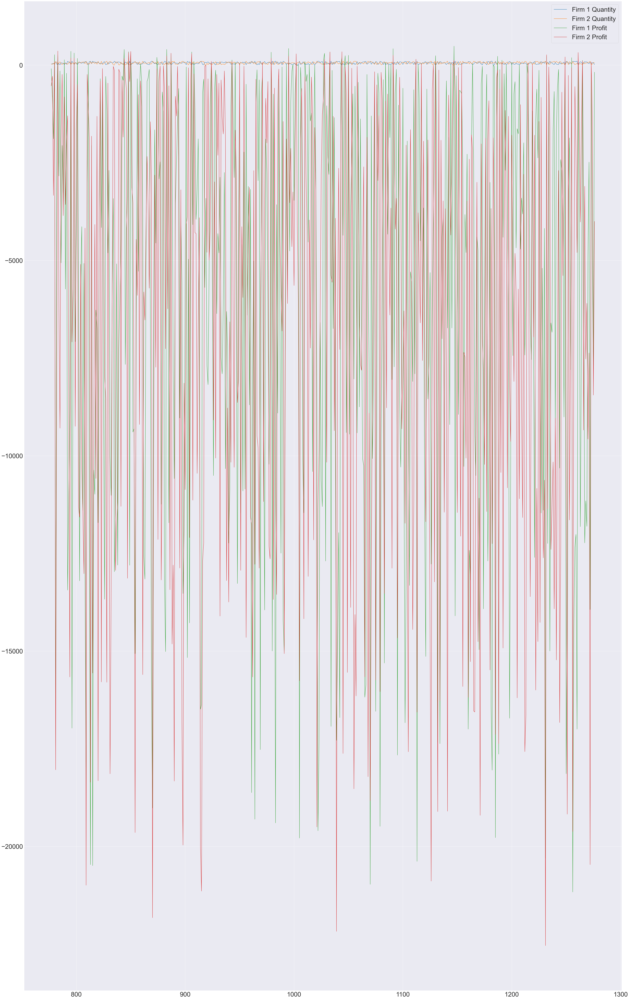

In [5]:
rand = generate_random_number(9500)
df.iloc[rand:rand+500, :].plot(figsize=(60, 100), fontsize=36)
plt.legend(fontsize=36)

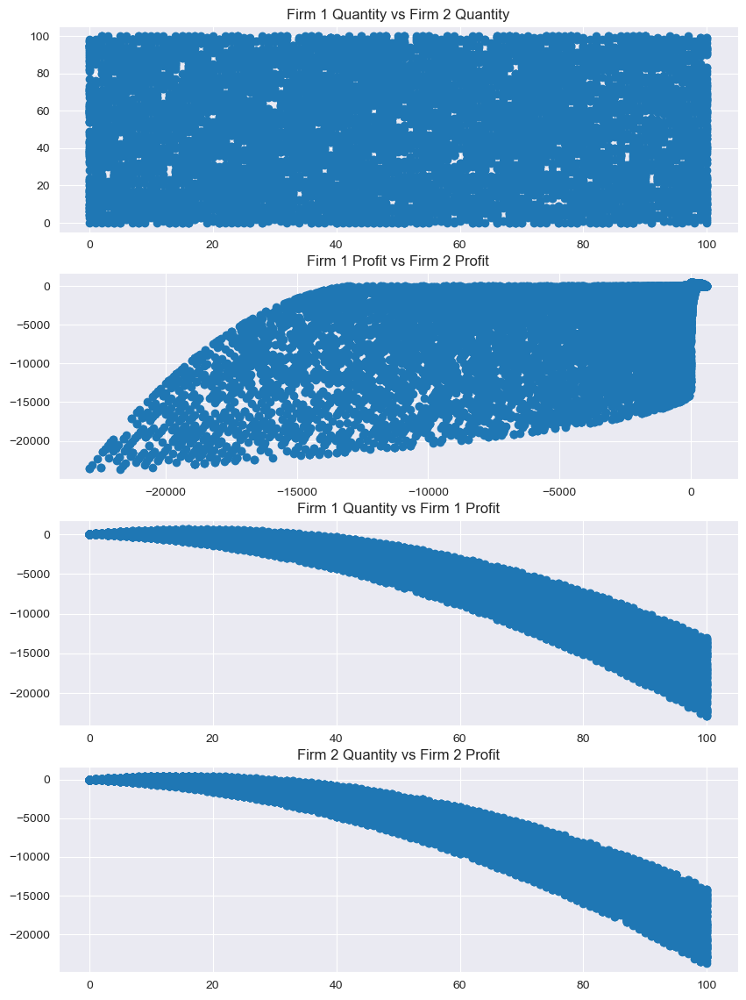

In [6]:
visualizer(df)

In [7]:
df.describe()

,Firm 1 Quantity,Firm 2 Quantity,Firm 1 Profit,Firm 2 Profit
count,10000.000000,10000.000000,10000.000000,10000.000000
mean,49.329500,50.216100,-5580.249100,-6218.381700
std,29.019554,29.204371,5679.080954,5970.187279
min,0.000000,0.000000,-22900.000000,-23700.000000
25%,24.000000,25.000000,-9490.000000,-10527.750000
50%,49.000000,51.000000,-3686.000000,-4473.000000
75%,74.000000,75.000000,-608.000000,-854.000000
max,100.000000,100.000000,608.000000,450.000000


Mean Profit for Firm 1: -5739.6794
Mean Profit for Firm 2: -6231.6754
Standard Deviation of Profit for Firm 1: 5754.53758167359
Standard Deviation of Profit for Firm 2: 5991.739539357963
***** MANN-WHITNEY U TEST *****
Mann-Whitney U statistic: 52581816.5
P-value: 2.5491059785775683e-10
Reject the null hypothesis: There is a significant difference in the mean profits.


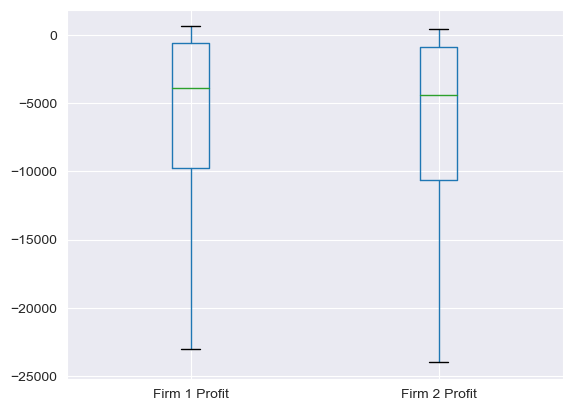

In [4]:
get_statistics(df)

In [7]:
sim1_results = get_profit(df)
print(f"Thus, out of {num_iterations} iterations, Firm 1 made a profit {sim1_results['firm1ProfitCount']/100}% of times, Firm 2 made a profit {sim1_results['firm2ProfitCount']/100}% of times, and both the firms profited simultaneously {sim1_results['bothProfitCount']/100}% of times.")

Thus, out of 10000 iterations, Firm 1 made a profit 11.29% of times, Firm 2 made a profit 8.2% of times, and both the firms profited simultaneously 6.19% of times.


## Simulation 2: Firm 1 has random quantity of production and Firm 2's quantity of production depends on Firm 1

In [8]:
f1_mean = int(df['Firm 1 Quantity'].mean())
df = mc_sim(
    num_iterations=num_iterations,
    demand_curve_coefficient=demand_curve_coefficient,
    c1=c1,
    c2=c2,
    q1max=101,
    q2=f1_mean,
    method='random'
)
df

,Firm 1 Quantity,Firm 2 Quantity,Firm 1 Profit,Firm 2 Profit
0,3,10,162,370
1,18,31,54,-620
2,7,4,364,180
3,59,20,-4012,-780
4,4,36,104,-576
...,...,...,...,...
9995,99,15,-14157,-1035
9996,89,22,-11570,-1606
9997,47,1,-1175,11
9998,95,35,-14725,-3675


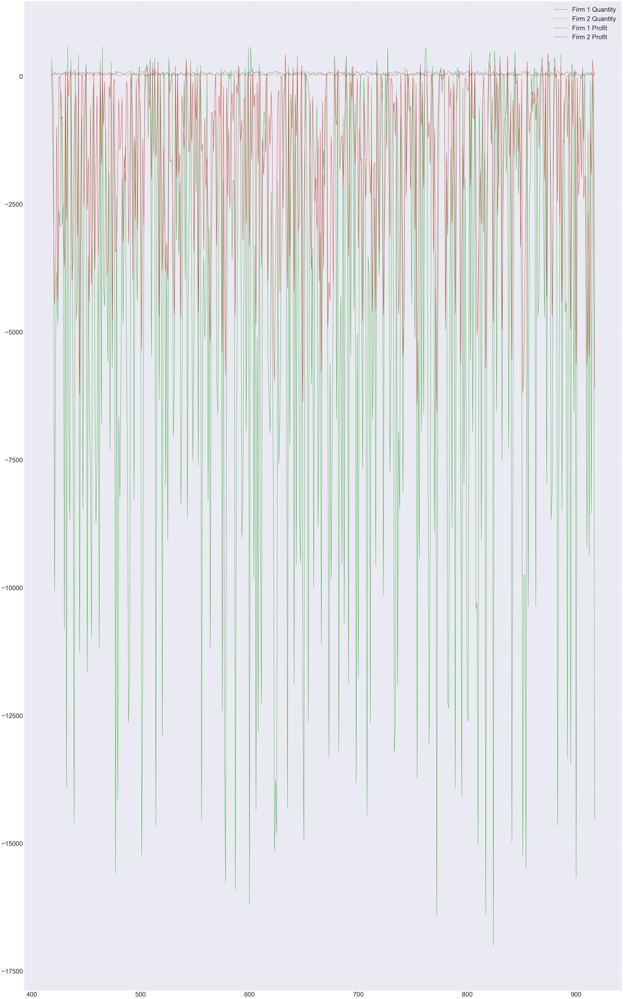

In [9]:
rand = generate_random_number(9500)
df.iloc[rand:rand+500, :].plot(figsize=(60, 100), fontsize=36)
plt.legend(fontsize=36)

In [10]:
sim2_results = get_profit(df)
print(f"Thus, out of {num_iterations} iterations, Firm 1 made a profit {sim2_results['firm1ProfitCount']/100}% of times, Firm 2 made a profit {sim2_results['firm2ProfitCount']/100}% of times, and both the firms profited simultaneously {sim2_results['bothProfitCount']/100}% of times.")

Thus, out of 10000 iterations, Firm 1 made a profit 21.23% of times, Firm 2 made a profit 16.94% of times, and both the firms profited simultaneously 12.66% of times.


## Simulation 3: Firm 1 and Firm 2 have lower costs of production

In [11]:
df = mc_sim(
    num_iterations=num_iterations,
    demand_curve_coefficient=demand_curve_coefficient,
    c1=np.random.randint(10, c1),
    c2=np.random.randint(10, c2),
    q1max=101,
    q2=0,
    method='random'
)
df

,Firm 1 Quantity,Firm 2 Quantity,Firm 1 Profit,Firm 2 Profit
0,79,97,-14536,-19400
1,83,1,-7968,-12
2,19,61,-532,-4148
3,12,36,132,-396
4,65,87,-9490,-14442
...,...,...,...,...
9995,87,97,-17400,-20176
9996,13,82,-481,-8528
9997,69,54,-8349,-5616
9998,35,43,-1470,-2064


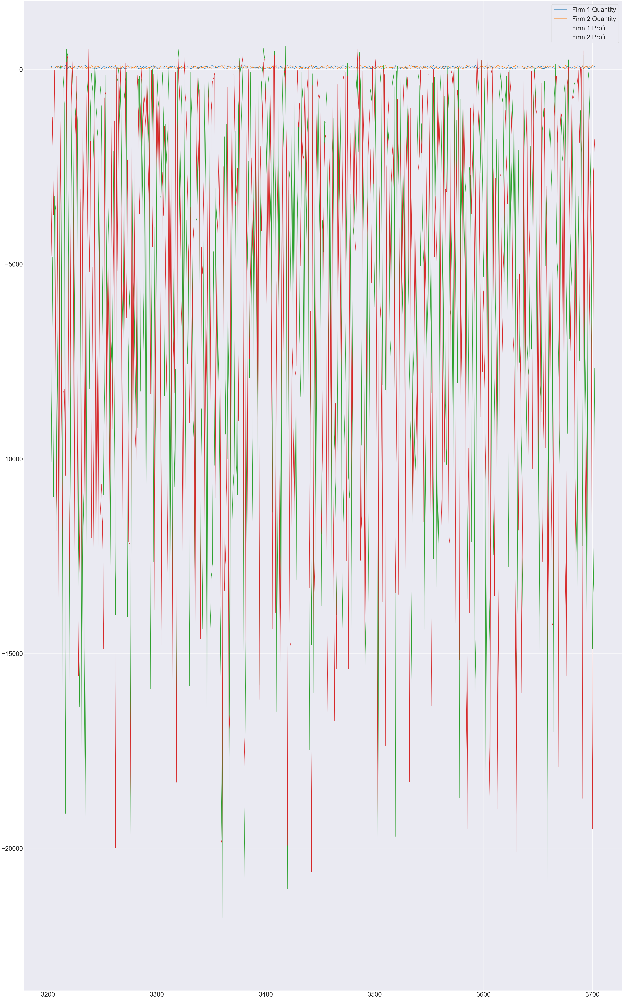

In [12]:
rand = generate_random_number(9500)
df.iloc[rand:rand+500, :].plot(figsize=(60, 100), fontsize=36)
plt.legend(fontsize=36)

In [13]:
sim3_results = get_profit(df)
print(f"Thus, out of {num_iterations} iterations, Firm 1 made a profit {sim3_results['firm1ProfitCount']/100}% of times, Firm 2 made a profit {sim3_results['firm2ProfitCount']/100}% of times, and both the firms profited simultaneously {sim3_results['bothProfitCount']/100}% of times.")

Thus, out of 10000 iterations, Firm 1 made a profit 12.18% of times, Firm 2 made a profit 12.36% of times, and both the firms profited simultaneously 7.7% of times.


## Simulation 4: Firm 2 has optimized quantity of production

In [7]:
df = mc_sim(
    num_iterations=num_iterations,
    demand_curve_coefficient=demand_curve_coefficient,
    c1=np.random.randint(10, c1),
    c2=np.random.randint(10, c2),
    q1max=101,
    q2=0,
    method='optimize'
)
df

,Firm 1 Quantity,Firm 2 Quantity,Firm 1 Profit,Firm 2 Profit
0,69,-1,-3795,0
1,44,11,-748,11
2,66,0,-3300,0
3,58,4,-2204,4
4,53,7,-1643,0
...,...,...,...,...
9995,39,14,-390,0
9996,47,10,-1034,0
9997,7,30,266,0
9998,98,-16,-9604,-16


In [8]:
get_statistics(df)

Mann-Whitney U statistic: 31384838.0
P-value: 0.0
Reject the null hypothesis: There is a significant difference in the mean profits.


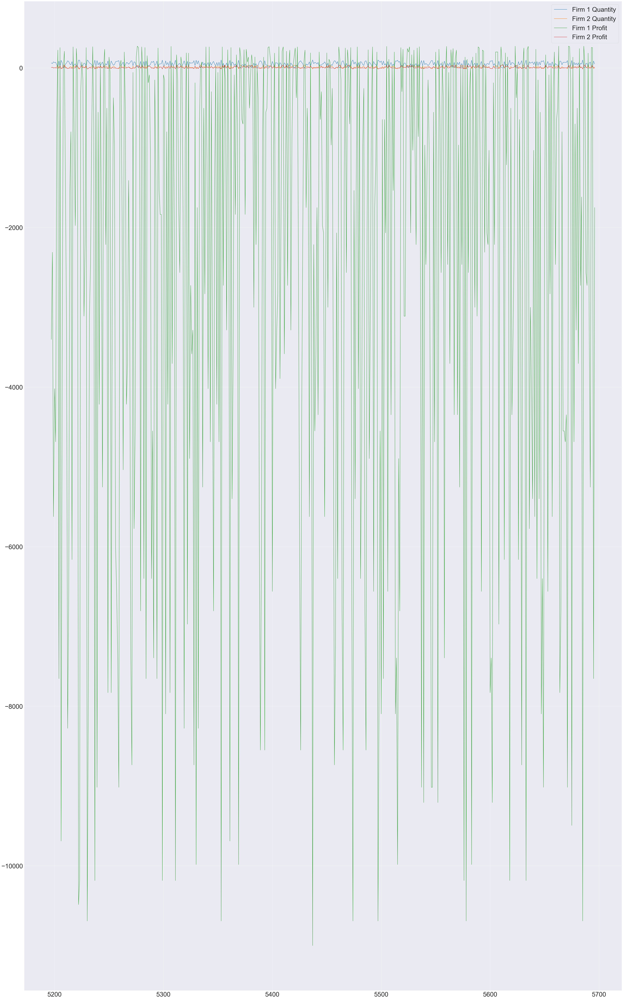

In [17]:
rand = generate_random_number(9500)
df.iloc[rand:rand+500, :].plot(figsize=(60, 100), fontsize=36)
plt.legend(fontsize=36)

In [18]:
sim4_results = get_profit(df)
print(f"Thus, out of {num_iterations} iterations, Firm 1 made a profit {sim4_results['firm1ProfitCount']/100}% of times, Firm 2 made a profit {sim4_results['firm2ProfitCount']/100}% of times, and both the firms profited simultaneously {sim4_results['bothProfitCount']/100}% of times.")

Thus, out of 10000 iterations, Firm 1 made a profit 24.81% of times, Firm 2 made a profit 35.42% of times, and both the firms profited simultaneously 12.15% of times.


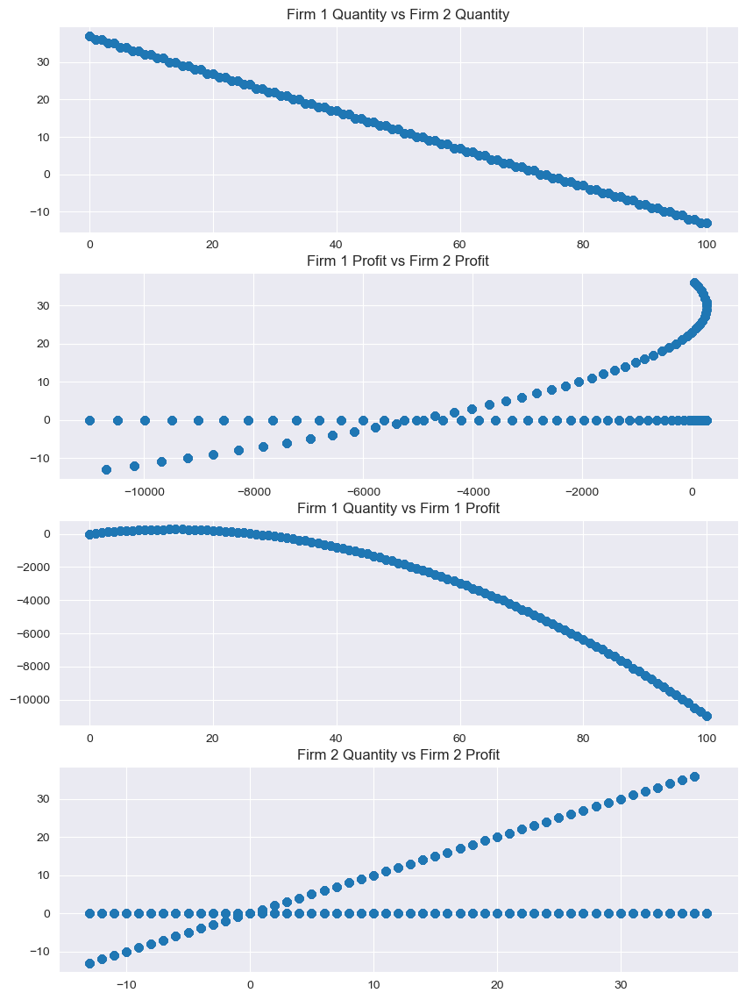

In [19]:
visualizer(df)